In [ ]:
import numpy as np
import cv2
import glob
import pickle
import matplotlib.pyplot as plt
from tracker import tracker
from moviepy.editor import VideoFileClip
import matplotlib.image as mpimg

In [ ]:
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output

def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

# Define a function to threshold an image for a given range and Sobel kernel
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

def color_threshold(image, sthresh=(0, 255),vthresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    S = hls[:,:,2]
    
    # 2) Apply a threshold to the S channel
    sbinary = np.zeros_like(S)
    sbinary[(S >= sthresh[0]) & (S <= sthresh[1])] = 1
    
    # 1) Convert to HSV color space
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    V = hsv[:,:,2]

    # 2) Apply a threshold to the S channel
    vbinary = np.zeros_like(V)
    vbinary[(V >= vthresh[0]) & (V <= vthresh[1])] = 1
    
    # 3) Return a binary image of threshold result
    binary_output = np.zeros_like(S)
    binary_output[(sbinary == 1) & (vbinary == 1)] = 1
#     print('color_threshold -',binary_output.shape)
    return binary_output

def window_mask(width,height,img_ref,center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output


def distort_fix_image(img):
    # Read in the saved objpoints and imgpoints
    dist_pickle = pickle.load( open( "calibration_pickle.p", "rb" ) )
    mtx = dist_pickle["mtx"]
    dist = dist_pickle["dist"]
    # Undistort
    img = cv2.undistort(img, mtx, dist, None, mtx)
    return img

def process_image_thresholding(img):
    preprocessimage = np.zeros_like(img[:,:,0])
    gradx = abs_sobel_thresh(img, orient='x', thresh_min=12, thresh_max=255)
    grady = abs_sobel_thresh(img, orient='y', thresh_min=25, thresh_max=255)
    color = color_threshold(img,sthresh = (100,255), vthresh = (50,255))
    
    dir_binary = dir_threshold(img, sobel_kernel=15, thresh=(0.7, 1.3))
    mag_binary = mag_thresh(img, sobel_kernel=3, mag_thresh=(30, 100))
    
    preprocessimage[((gradx == 1) & (grady == 1) | (color == 1) |((dir_binary == 1) & (mag_binary == 1)) )] = 255
    return preprocessimage


def perspective_transform(img, preprocessimage):
    h, w = img.shape[:2]

    src = np.float32([[w, h-10],    # br
                      [0, h-10],    # bl
                      [546, 460],   # tl
                      [732, 460]])  # tr
    dst = np.float32([[w, h],       # br
                      [0, h],       # bl
                      [0, 0],       # tl
                      [w, 0]])      # tr
    M = cv2.getPerspectiveTransform(src, dst)
    M_inv = cv2.getPerspectiveTransform(dst,src)
    warped = cv2.warpPerspective(preprocessimage, M, (w, h), flags=cv2.INTER_LINEAR)
    return M,M_inv,warped


In [3]:
# Prepare object points
objp = np.zeros((6*9,3),np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

objpoints = []
imgpoints = []
nx = 9
ny = 6


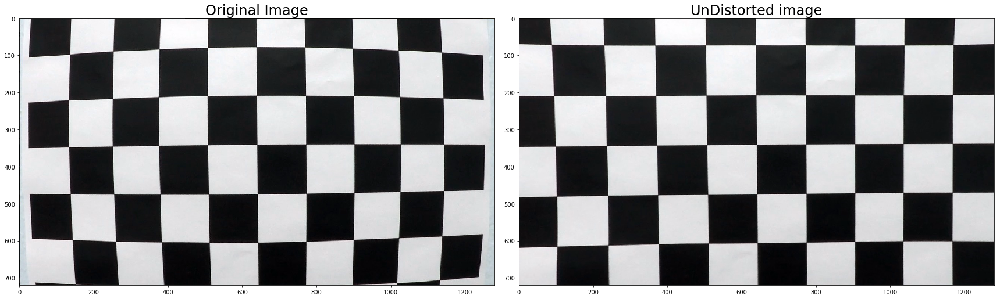

In [4]:
# Iterate over all the images in camera cal folder
images = glob.glob('./camera_cal/calibration*.jpg')
for idx,fname in enumerate(images):
#     print('Processing',fname)
    img = cv2.imread(fname)
    
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        
        cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        name = './camera_cal/camera_cal_marked/corner_marked'+str(idx)+'.jpg'
        cv2.imwrite(name,img)
        
# Loading image for referance and size
img_ref = cv2.imread('./camera_cal/calibration1.jpg')
ref_shape = (img_ref.shape[1],img_ref.shape[0])
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, ref_shape,None,None)

dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
# Save the pickle file
pickle.dump(dist_pickle, open( "calibration_pickle.p", "wb" ) )

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img_ref)
ax1.set_title('Original Image', fontsize=24)

img_ref = distort_fix_image(img_ref)
ax2.imshow(img_ref, cmap='gray')
ax2.set_title('UnDistorted image', fontsize=24)

plt.show()

In [5]:
def process_img(img):
    f, (ax1, ax2,ax3,ax4,ax5) = plt.subplots(1, 5, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=24)
    
    img = distort_fix_image(img)
    ax2.imshow(img, cmap='gray')
    ax2.set_title('UnDistorted image', fontsize=24)
    
    # Thresholding
    preprocessimage = process_image_thresholding(img)
    name = './test_images/test_images_preprocessimage/undistorted'+str(idx)+'.jpg'
    cv2.imwrite(name,preprocessimage)
    ax3.imshow(preprocessimage)
    ax3.set_title('Pre processed image', fontsize=24)

    img_size = (img.shape[1], img.shape[0]) # (1280, 720)
    M, M_inv, warped = perspective_transform(img, preprocessimage)

    name = './test_images/warpPerspective/undistorted'+str(idx)+'.jpg'
    cv2.imwrite(name,warped)
        
    ax4.imshow(warped, cmap='gray')
    ax4.set_title('perspective transformed', fontsize=24)


    # Lane detection using Tracker class
    window_width = 80
    window_height = 160
    margin = 100
    curve_centers = tracker(window_width=window_width,window_height=window_height,margin=margin,ym = 10/720,xm = 4/384,smooth_factor = 50)

    window_centroids = curve_centers.find_window_centroids(warped)
    leftx = []
    rightx = []
    # points to draw all left and right windows
    l_points = np.zeros_like(warped)
    r_points = np.zeros_like(warped)

    #drwaing the windows
    for level in range(0,len(window_centroids)):
        l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
        r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)

        leftx.append(window_centroids[level][0])
        rightx.append(window_centroids[level][1])

        # add graphic points
        l_points[(l_points == 255)|(l_mask == 1)] = 255
        r_points[(r_points == 255)|(r_mask == 1)] = 255


    # Draw the results
    template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
    zero_channel = np.zeros_like(template) # create a zero color channle 
    template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
    warpage = np.array(cv2.merge((warped,warped,warped)),np.uint8) # making the original road pixels 3 color channels
    result = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
    
    name = './test_images/test_images_preprocessimage1/undistorted'+str(idx)+'.jpg'
    cv2.imwrite(name,result)

    # Fit a second order polynomial to pixel positions in each lane line
    yvals = range(0,warped.shape[0])
    res_yvals = np.arange(warped.shape[0]-(window_height/2),0,-window_height)

    left_fit = np.polyfit(res_yvals, leftx, 2)
    left_fitx = left_fit[0]*yvals*yvals + left_fit[1]*yvals + left_fit[2]
    left_fitx = np.array(left_fitx,np.int32)

    right_fit = np.polyfit(res_yvals, rightx, 2)
    right_fitx = right_fit[0]*yvals*yvals + right_fit[1]*yvals + right_fit[2]
    right_fitx = np.array(right_fitx,np.int32)

    left_lane = np.array(list(zip(np.concatenate((left_fitx-window_width/2,left_fitx[::-1]+window_width/2),axis=0),
                                 np.concatenate((yvals,yvals[::-1]),axis=0))),np.int32)
    right_lane = np.array(list(zip(np.concatenate((right_fitx-window_width/2,right_fitx[::-1]+window_width/2),axis=0),
                                 np.concatenate((yvals,yvals[::-1]),axis=0))),np.int32)
    inner_lane = np.array(list(zip(np.concatenate((left_fitx-window_width/2,right_fitx[::-1]-window_width/2),axis=0),
                                 np.concatenate((yvals,yvals[::-1]),axis=0))),np.int32)

    road = np.zeros_like(img)
    road_bkg = np.zeros_like(img)
    cv2.fillPoly(road,[left_lane],color = [255,0,0])
    cv2.fillPoly(road,[right_lane],color = [0,0,255])
    cv2.fillPoly(road,[inner_lane],color = [0,255,0])
    cv2.fillPoly(road_bkg,[left_lane],color = [255,255,255])
    cv2.fillPoly(road_bkg,[left_lane],color = [255,255,255])

    road_warped = cv2.warpPerspective(road,M_inv,img_size,flags= cv2.INTER_LINEAR)
    name = './test_images/road_warped/undistorted'+str(idx)+'.jpg'
    cv2.imwrite(name,road_warped)
    road_warped_bkg = cv2.warpPerspective(road_bkg,M_inv,img_size,flags= cv2.INTER_LINEAR)

    base = cv2.addWeighted(img,1.0,road_warped_bkg,-1.0,0.0)
    result = cv2.addWeighted(base,1.0,road_warped,0.7,0.0)

    # calculate the offset of the car on road
    xm = curve_centers.xm_per_pix
    ym = curve_centers.ym_per_pix
    curve_fit_rad = np.polyfit(np.array(res_yvals,np.float32)*ym,np.array(leftx,np.float32)*xm,2)
    curverad = ((1+(2*curve_fit_rad[0]*yvals[-1]*ym + curve_fit_rad[1])**2)**1.5)/np.absolute(2*curve_fit_rad[0])
    camera_center = (left_fitx[-1]+right_fitx[-1])/2
    center_diff = (camera_center-warped.shape[1]/2)*xm
    side_pos = 'left'
    if center_diff <= 0:
        side_pos = 'right'

    # show curvature,offset and speed
    cv2.putText(result,'Radius of curvature ='+str(round(curverad,3))+'(m)',(50,50), cv2.FONT_HERSHEY_SIMPLEX,1,(255,255,255),2)
    cv2.putText(result,'Vehicle is '+str(abs(round(center_diff,3)))+' m '+side_pos+' of center',(50,100), cv2.FONT_HERSHEY_SIMPLEX,1,(255,255,255),2)

    name = './test_images/test_images_undistorted/undistorted'+str(idx)+'.jpg'
    cv2.imwrite(name,result)
    ax5.imshow(result, cmap='gray')
    ax5.set_title('final', fontsize=24)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    return result

./test_images/straight_lines1.jpg
First  (222.0, 1069.0)
1 (229.0, 1070.0)
2 (245.0, 1074.0)
3 (241.0, 1068.0)
[[  222.  1069.]
 [  229.  1070.]
 [  245.  1074.]
 [  241.  1068.]]


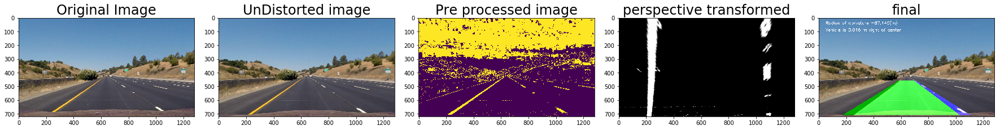

./test_images/straight_lines2.jpg
First  (218.0, 1101.0)
1 (1086.0, 1086.0)
2 (1093.0, 1093.0)
3 (1094.0, 1094.0)
[[  218.  1101.]
 [  218.  1086.]
 [  218.  1093.]
 [  218.  1094.]]


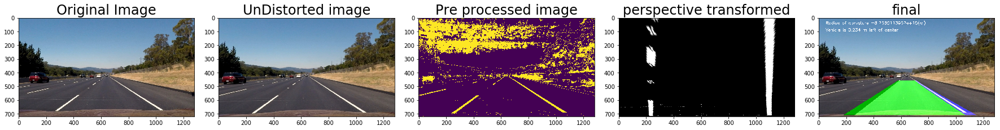

./test_images/test1.jpg
First  (248.0, 1159.0)
1 (271.0, 1167.0)
2 (286.0, 1183.0)
3 (317.0, 1221.0)
[[  248.  1159.]
 [  271.  1167.]
 [  286.  1183.]
 [  317.  1221.]]


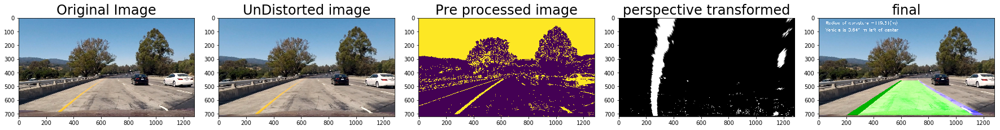

./test_images/test2.jpg
First  (295.0, 1128.0)
1 (299.0, 1135.0)
2 (268.0, 1116.0)
3 (228.0, 1042.0)
[[  295.  1128.]
 [  299.  1135.]
 [  268.  1116.]
 [  228.  1042.]]


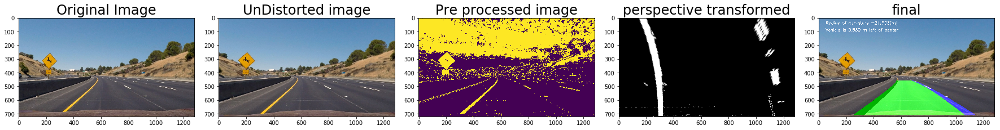

./test_images/test3.jpg
First  (270.0, 1132.0)
1 (300.0, 1151.0)
2 (345.0, 1179.0)
3 (392.0, 1229.0)
[[  270.  1132.]
 [  300.  1151.]
 [  345.  1179.]
 [  392.  1229.]]


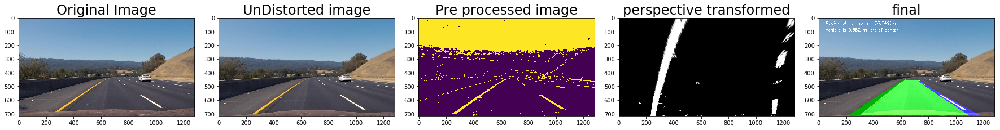

./test_images/test4.jpg
First  (287.0, 1182.0)
1 (297.0, 1175.0)
2 (301.0, 1203.0)
3 (325.0, 1228.0)
[[  287.  1182.]
 [  297.  1175.]
 [  301.  1203.]
 [  325.  1228.]]


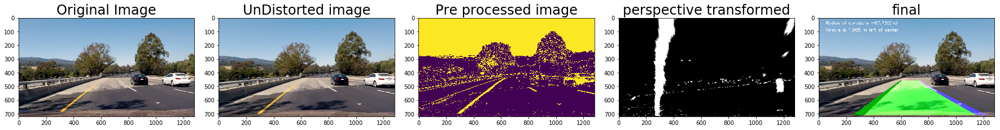

./test_images/test5.jpg
First  (202.0, 1119.0)
1 (204.0, 1154.0)
2 (237.0, 1175.0)
3 (298.0, 1196.0)
[[  202.  1119.]
 [  204.  1154.]
 [  237.  1175.]
 [  298.  1196.]]


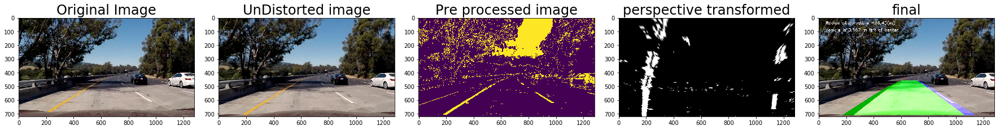

./test_images/test6.jpg
First  (290.0, 1181.0)
1 (321.0, 1193.0)
2 (368.0, 1230.0)
3 (417.0, 1239.0)
[[  290.  1181.]
 [  321.  1193.]
 [  368.  1230.]
 [  417.  1239.]]


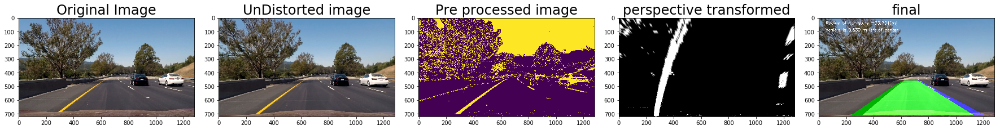

Done


In [6]:
dist_pickle = pickle.load( open( "calibration_pickle.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]

images = glob.glob('./test_images/*.jpg')
for idx,fname in enumerate(images):
#     if idx>3: break
    print(fname)
    img = mpimg.imread(fname)
    result = process_img(img)
print('Done')

First  (307.0, 1157.0)
1 (281.0, 1154.0)
2 (263.0, 1103.0)
3 (228.0, 1084.0)
[[  307.  1157.]
 [  281.  1154.]
 [  263.  1103.]
 [  228.  1084.]]


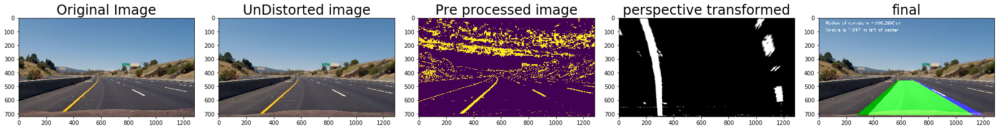

[MoviePy] >>>> Building video output1_tracked.mp4
[MoviePy] Writing video output1_tracked.mp4


  0%|          | 0/1261 [00:00<?, ?it/s]

First  (307.0, 1157.0)
1 (281.0, 1154.0)
2 (263.0, 1103.0)
3 (228.0, 1084.0)
[[  307.  1157.]
 [  281.  1154.]
 [  263.  1103.]
 [  228.  1084.]]


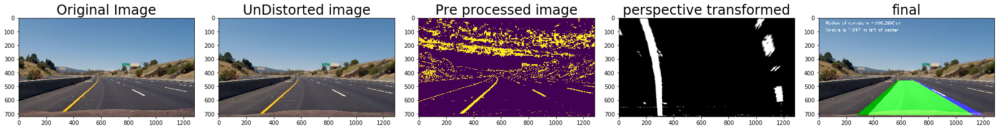

  0%|          | 1/1261 [00:01<33:29,  1.59s/it]

First  (310.0, 1156.0)
1 (283.0, 1146.0)
2 (264.0, 1095.0)
3 (227.0, 1084.0)
[[  310.  1156.]
 [  283.  1146.]
 [  264.  1095.]
 [  227.  1084.]]


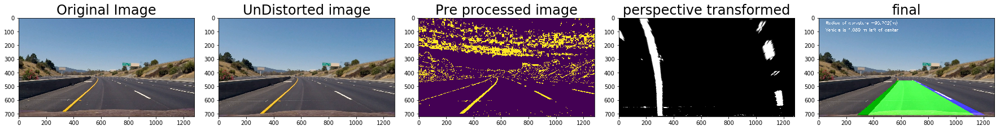

  0%|          | 2/1261 [00:03<33:16,  1.59s/it]

First  (311.0, 1166.0)
1 (284.0, 1138.0)
2 (268.0, 1093.0)
3 (228.0, 1059.0)
[[  311.  1166.]
 [  284.  1138.]
 [  268.  1093.]
 [  228.  1059.]]


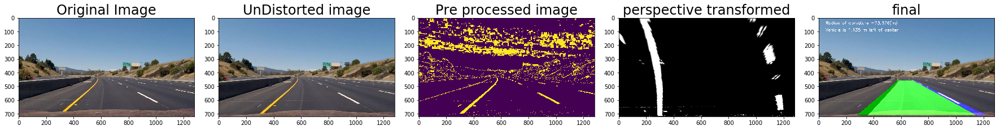

  0%|          | 3/1261 [00:04<33:36,  1.60s/it]

First  (308.0, 1166.0)
1 (284.0, 1141.0)
2 (267.0, 1097.0)
3 (227.0, 1044.0)
[[  308.  1166.]
 [  284.  1141.]
 [  267.  1097.]
 [  227.  1044.]]


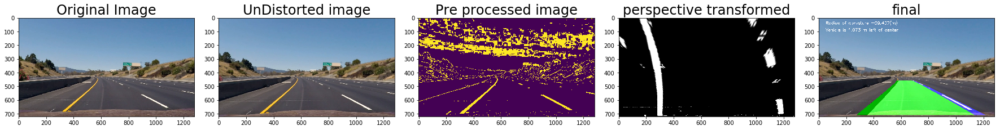

  0%|          | 4/1261 [00:06<33:25,  1.60s/it]

First  (287.0, 1170.0)
1 (285.0, 1145.0)
2 (267.0, 1104.0)
3 (224.0, 1051.0)
[[  287.  1170.]
 [  285.  1145.]
 [  267.  1104.]
 [  224.  1051.]]


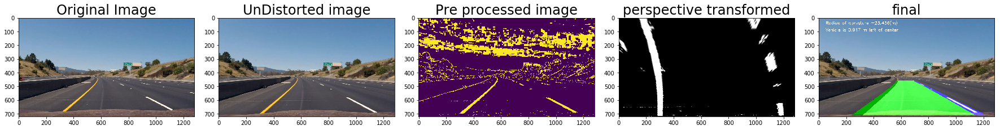

  0%|          | 5/1261 [00:07<33:16,  1.59s/it]

First  (287.0, 1170.0)
1 (298.0, 1127.0)
2 (268.0, 1107.0)
3 (223.0, 1024.0)
[[  287.  1170.]
 [  298.  1127.]
 [  268.  1107.]
 [  223.  1024.]]


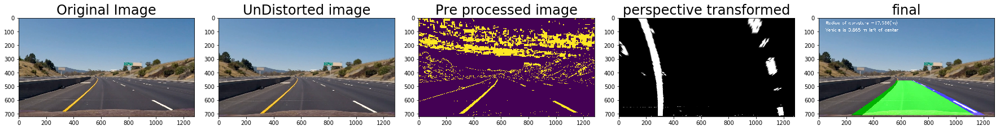

  0%|          | 6/1261 [00:09<33:16,  1.59s/it]

First  (315.0, 1159.0)
1 (297.0, 1132.0)
2 (264.0, 1114.0)
3 (221.0, 1027.0)
[[  315.  1159.]
 [  297.  1132.]
 [  264.  1114.]
 [  221.  1027.]]


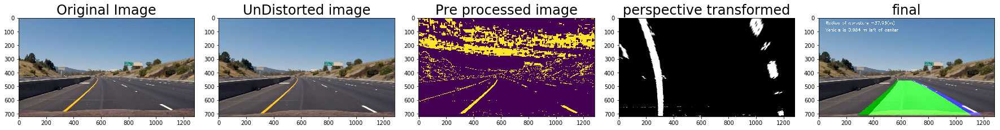

  1%|          | 7/1261 [00:11<32:25,  1.55s/it]

First  (318.0, 1154.0)
1 (298.0, 1121.0)
2 (265.0, 1105.0)
3 (223.0, 1008.0)
[[  318.  1154.]
 [  298.  1121.]
 [  265.  1105.]
 [  223.  1008.]]


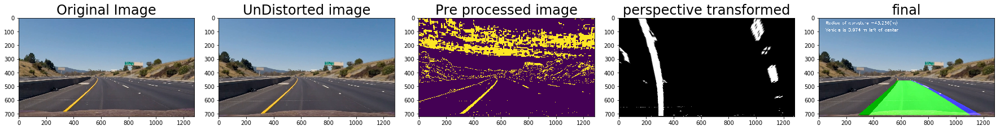

  1%|          | 8/1261 [00:12<32:02,  1.53s/it]

First  (315.0, 1158.0)
1 (294.0, 1127.0)
2 (262.0, 1106.0)
3 (220.0, 1017.0)
[[  315.  1158.]
 [  294.  1127.]
 [  262.  1106.]
 [  220.  1017.]]


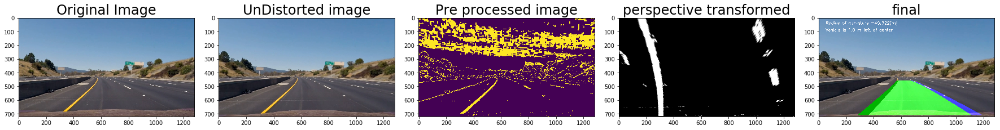

  1%|          | 9/1261 [00:13<31:25,  1.51s/it]

First  (314.0, 1162.0)
1 (290.0, 1133.0)
2 (258.0, 1090.0)
3 (219.0, 1025.0)
[[  314.  1162.]
 [  290.  1133.]
 [  258.  1090.]
 [  219.  1025.]]


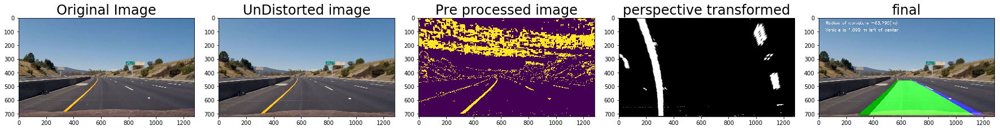

  1%|          | 10/1261 [00:15<31:09,  1.49s/it]

First  (315.0, 1162.0)
1 (292.0, 1135.0)
2 (256.0, 1089.0)
3 (1030.0, 1030.0)
[[  315.  1162.]
 [  292.  1135.]
 [  256.  1089.]
 [  256.  1030.]]


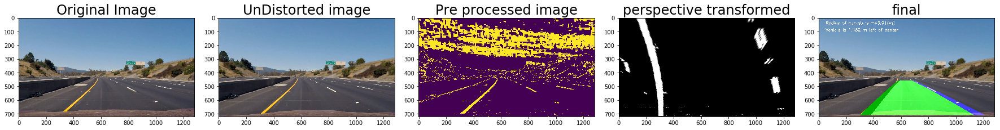

  1%|          | 11/1261 [00:17<31:58,  1.54s/it]

First  (308.0, 1168.0)
1 (278.0, 1148.0)
2 (248.0, 1107.0)
3 (1052.0, 1052.0)
[[  308.  1168.]
 [  278.  1148.]
 [  248.  1107.]
 [  248.  1052.]]


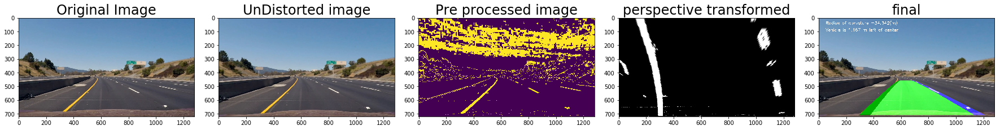

  1%|          | 12/1261 [00:18<31:26,  1.51s/it]

First  (308.0, 1151.0)
1 (278.0, 1147.0)
2 (247.0, 1077.0)
3 (200.0, 1054.0)
[[  308.  1151.]
 [  278.  1147.]
 [  247.  1077.]
 [  200.  1054.]]


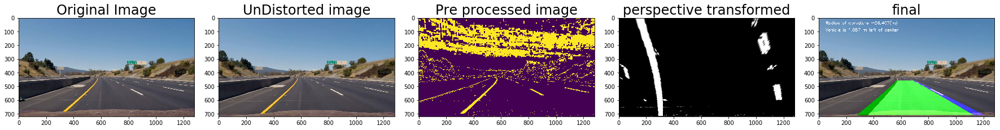

  1%|          | 13/1261 [00:19<30:55,  1.49s/it]

First  (308.0, 1153.0)
1 (277.0, 1142.0)
2 (247.0, 1074.0)
3 (198.0, 1058.0)
[[  308.  1153.]
 [  277.  1142.]
 [  247.  1074.]
 [  198.  1058.]]


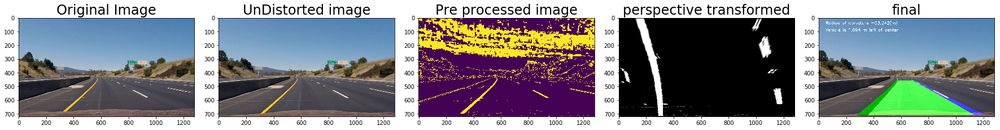

  1%|          | 14/1261 [00:21<31:21,  1.51s/it]

First  (309.0, 1152.0)
1 (278.0, 1127.0)
2 (248.0, 1060.0)
3 (201.0, 1035.0)
[[  309.  1152.]
 [  278.  1127.]
 [  248.  1060.]
 [  201.  1035.]]


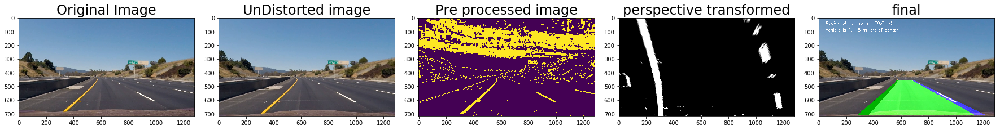

  1%|          | 15/1261 [00:22<31:09,  1.50s/it]

First  (311.0, 1156.0)
1 (281.0, 1108.0)
2 (249.0, 1060.0)
3 (206.0, 1014.0)
[[  311.  1156.]
 [  281.  1108.]
 [  249.  1060.]
 [  206.  1014.]]


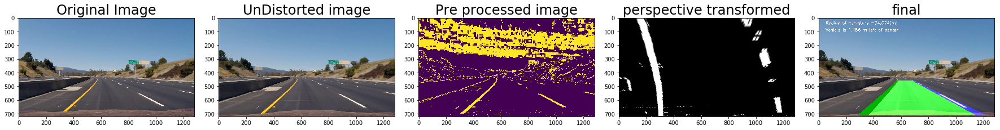

  1%|▏         | 16/1261 [00:24<30:55,  1.49s/it]

First  (308.0, 1162.0)
1 (279.0, 1113.0)
2 (247.0, 1065.0)
3 (205.0, 1012.0)
[[  308.  1162.]
 [  279.  1113.]
 [  247.  1065.]
 [  205.  1012.]]


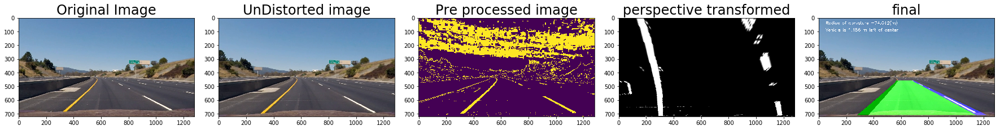

  1%|▏         | 17/1261 [00:25<31:21,  1.51s/it]

First  (309.0, 1170.0)
1 (283.0, 1097.0)
2 (245.0, 1070.0)
3 (206.0, 988.0)
[[  309.  1170.]
 [  283.  1097.]
 [  245.  1070.]
 [  206.   988.]]


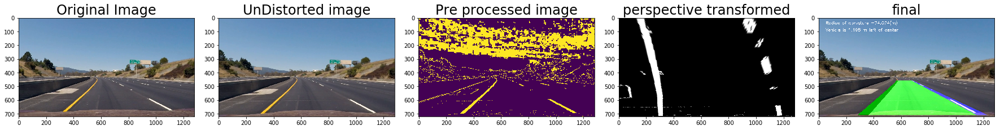

  1%|▏         | 18/1261 [00:27<30:56,  1.49s/it]

First  (305.0, 1145.0)
1 (277.0, 1102.0)
2 (241.0, 1081.0)
3 (202.0, 990.0)
[[  305.  1145.]
 [  277.  1102.]
 [  241.  1081.]
 [  202.   990.]]


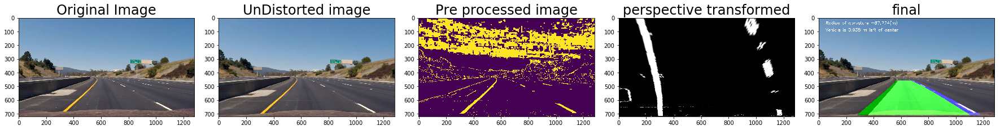

  2%|▏         | 19/1261 [00:28<31:08,  1.50s/it]

First  (300.0, 1148.0)
1 (272.0, 1101.0)
2 (237.0, 1087.0)
3 (200.0, 987.0)
[[  300.  1148.]
 [  272.  1101.]
 [  237.  1087.]
 [  200.   987.]]


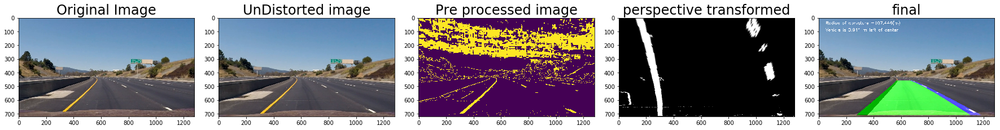

  2%|▏         | 20/1261 [00:30<30:52,  1.49s/it]

First  (299.0, 1160.0)
1 (270.0, 1106.0)
2 (235.0, 1090.0)
3 (197.0, 997.0)
[[  299.  1160.]
 [  270.  1106.]
 [  235.  1090.]
 [  197.   997.]]


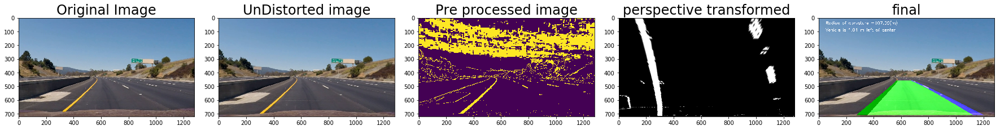

  2%|▏         | 21/1261 [00:31<30:42,  1.49s/it]

First  (288.0, 1157.0)
1 (265.0, 1115.0)
2 (230.0, 1094.0)
3 (193.0, 1012.0)
[[  288.  1157.]
 [  265.  1115.]
 [  230.  1094.]
 [  193.  1012.]]


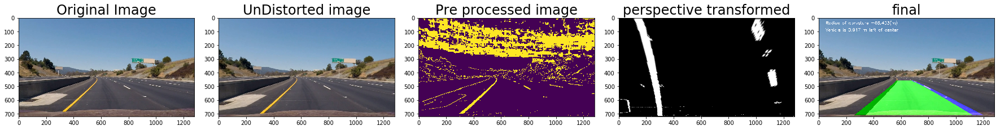

  2%|▏         | 22/1261 [00:33<31:04,  1.51s/it]

First  (288.0, 1149.0)
1 (259.0, 1125.0)
2 (228.0, 1090.0)
3 (191.0, 1027.0)
[[  288.  1149.]
 [  259.  1125.]
 [  228.  1090.]
 [  191.  1027.]]


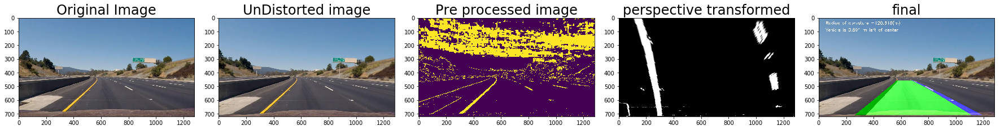

  2%|▏         | 23/1261 [00:34<30:41,  1.49s/it]

First  (290.0, 1150.0)
1 (261.0, 1127.0)
2 (230.0, 1093.0)
3 (195.0, 1031.0)
[[  290.  1150.]
 [  261.  1127.]
 [  230.  1093.]
 [  195.  1031.]]


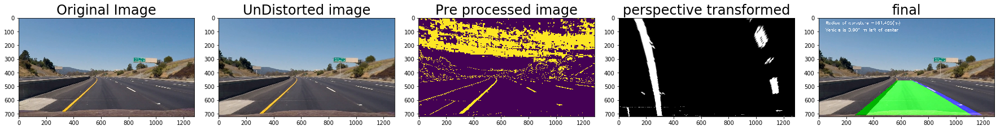

  2%|▏         | 24/1261 [00:36<30:51,  1.50s/it]

First  (290.0, 1151.0)
1 (258.0, 1130.0)
2 (233.0, 1090.0)
3 (194.0, 1038.0)
[[  290.  1151.]
 [  258.  1130.]
 [  233.  1090.]
 [  194.  1038.]]


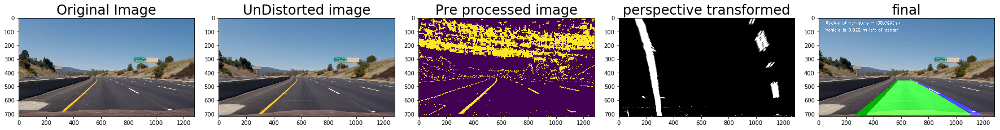

  2%|▏         | 25/1261 [00:38<31:23,  1.52s/it]

First  (286.0, 1137.0)
1 (253.0, 1135.0)
2 (231.0, 1078.0)
3 (189.0, 1055.0)
[[  286.  1137.]
 [  253.  1135.]
 [  231.  1078.]
 [  189.  1055.]]


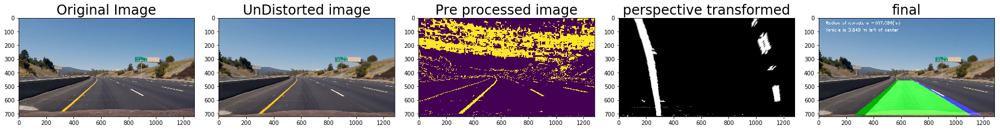

  2%|▏         | 26/1261 [00:39<31:01,  1.51s/it]

First  (283.0, 1143.0)
1 (255.0, 1132.0)
2 (231.0, 1079.0)
3 (189.0, 1064.0)
[[  283.  1143.]
 [  255.  1132.]
 [  231.  1079.]
 [  189.  1064.]]


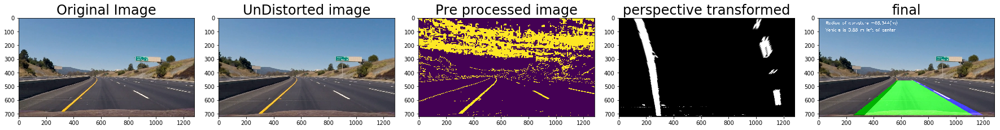

  2%|▏         | 27/1261 [00:40<30:39,  1.49s/it]

First  (278.0, 1149.0)
1 (254.0, 1139.0)
2 (227.0, 1088.0)
3 (186.0, 1078.0)
[[  278.  1149.]
 [  254.  1139.]
 [  227.  1088.]
 [  186.  1078.]]


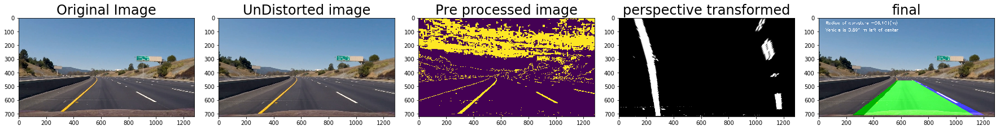

  2%|▏         | 28/1261 [00:42<30:54,  1.50s/it]

First  (280.0, 1167.0)
1 (254.0, 1134.0)
2 (232.0, 1088.0)
3 (190.0, 1068.0)
[[  280.  1167.]
 [  254.  1134.]
 [  232.  1088.]
 [  190.  1068.]]


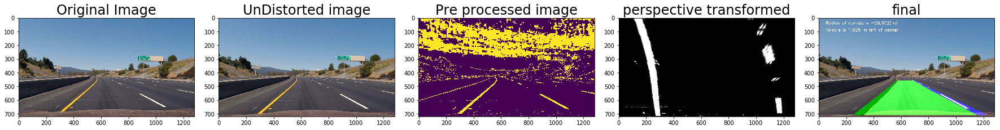

  2%|▏         | 29/1261 [00:43<30:46,  1.50s/it]

First  (281.0, 1161.0)
1 (254.0, 1134.0)
2 (234.0, 1090.0)
3 (194.0, 1042.0)
[[  281.  1161.]
 [  254.  1134.]
 [  234.  1090.]
 [  194.  1042.]]


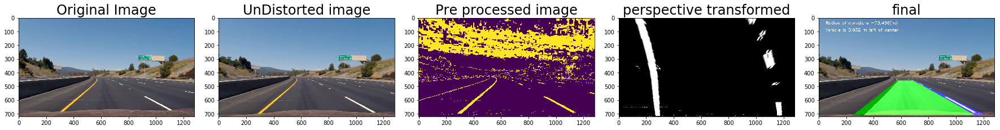

  2%|▏         | 30/1261 [00:45<30:59,  1.51s/it]

First  (286.0, 1171.0)
1 (268.0, 1136.0)
2 (240.0, 1094.0)
3 (198.0, 1044.0)
[[  286.  1171.]
 [  268.  1136.]
 [  240.  1094.]
 [  198.  1044.]]


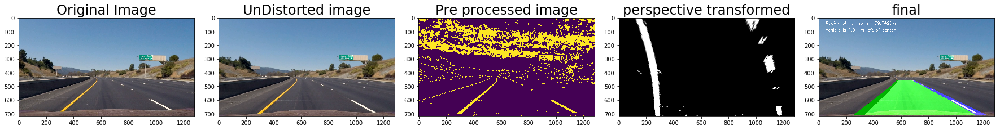

  2%|▏         | 31/1261 [00:47<32:07,  1.57s/it]

First  (289.0, 1147.0)
1 (275.0, 1114.0)
2 (243.0, 1093.0)
3 (203.0, 1002.0)
[[  289.  1147.]
 [  275.  1114.]
 [  243.  1093.]
 [  203.  1002.]]


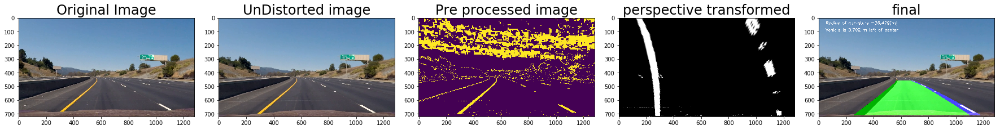

  3%|▎         | 32/1261 [00:48<32:07,  1.57s/it]

First  (286.0, 1150.0)
1 (273.0, 1114.0)
2 (242.0, 1098.0)
3 (204.0, 998.0)
[[  286.  1150.]
 [  273.  1114.]
 [  242.  1098.]
 [  204.   998.]]


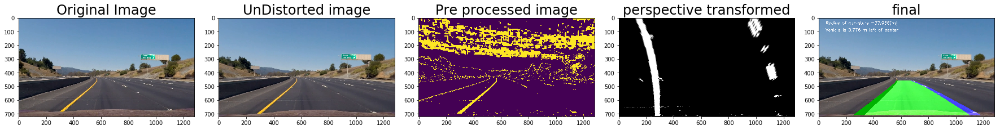

  3%|▎         | 33/1261 [00:50<32:14,  1.58s/it]

First  (291.0, 1144.0)
1 (277.0, 1114.0)
2 (243.0, 1092.0)
3 (207.0, 1000.0)
[[  291.  1144.]
 [  277.  1114.]
 [  243.  1092.]
 [  207.  1000.]]


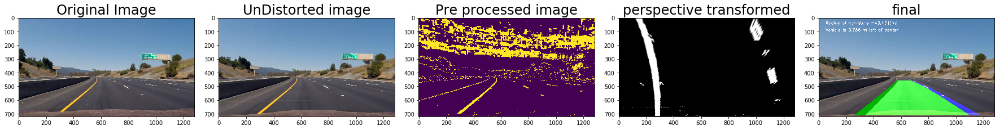

  3%|▎         | 34/1261 [00:51<31:45,  1.55s/it]

First  (294.0, 1168.0)
1 (276.0, 1119.0)
2 (247.0, 1085.0)
3 (209.0, 1004.0)
[[  294.  1168.]
 [  276.  1119.]
 [  247.  1085.]
 [  209.  1004.]]


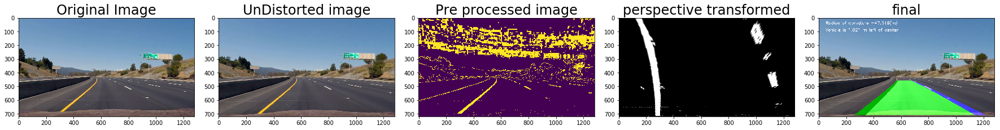

  3%|▎         | 35/1261 [00:53<31:07,  1.52s/it]

First  (297.0, 1169.0)
1 (281.0, 1123.0)
2 (249.0, 1079.0)
3 (1012.0, 1012.0)
[[  297.  1169.]
 [  281.  1123.]
 [  249.  1079.]
 [  249.  1012.]]


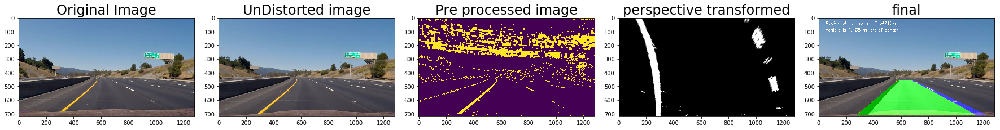

  3%|▎         | 36/1261 [00:54<31:31,  1.54s/it]

First  (299.0, 1149.0)
1 (269.0, 1127.0)
2 (250.0, 1071.0)
3 (208.0, 1022.0)
[[  299.  1149.]
 [  269.  1127.]
 [  250.  1071.]
 [  208.  1022.]]


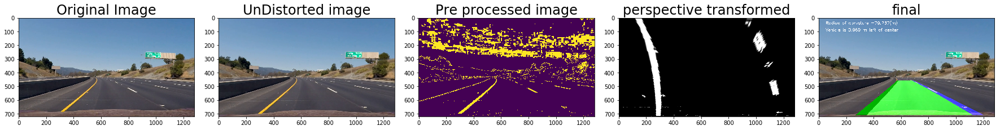

  3%|▎         | 37/1261 [00:56<31:37,  1.55s/it]

First  (301.0, 1143.0)
1 (272.0, 1128.0)
2 (253.0, 1055.0)
3 (208.0, 1027.0)
[[  301.  1143.]
 [  272.  1128.]
 [  253.  1055.]
 [  208.  1027.]]


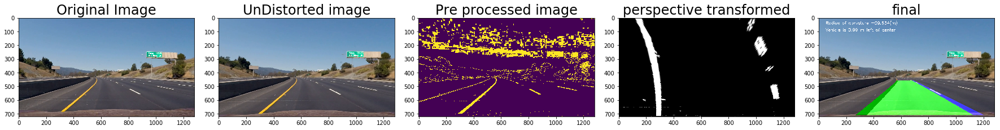

  3%|▎         | 38/1261 [00:58<31:28,  1.54s/it]

First  (303.0, 1134.0)
1 (273.0, 1115.0)
2 (256.0, 1039.0)
3 (208.0, 1028.0)
[[  303.  1134.]
 [  273.  1115.]
 [  256.  1039.]
 [  208.  1028.]]


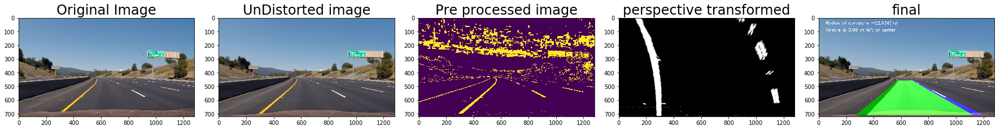

  3%|▎         | 39/1261 [00:59<31:50,  1.56s/it]

First  (303.0, 1148.0)
1 (273.0, 1118.0)
2 (253.0, 1046.0)
3 (204.0, 1007.0)
[[  303.  1148.]
 [  273.  1118.]
 [  253.  1046.]
 [  204.  1007.]]


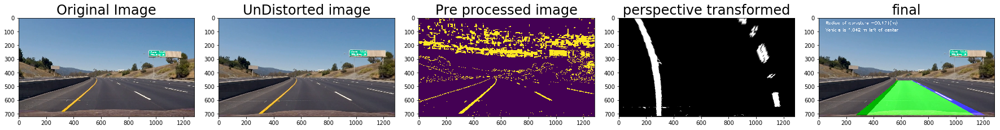

  3%|▎         | 40/1261 [01:01<31:34,  1.55s/it]

First  (303.0, 1147.0)
1 (274.0, 1107.0)
2 (254.0, 1054.0)
3 (203.0, 1009.0)
[[  303.  1147.]
 [  274.  1107.]
 [  254.  1054.]
 [  203.  1009.]]


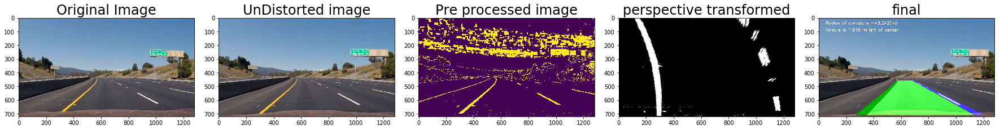

  3%|▎         | 41/1261 [01:02<31:41,  1.56s/it]

First  (304.0, 1146.0)
1 (276.0, 1113.0)
2 (253.0, 1065.0)
3 (202.0, 1003.0)
[[  304.  1146.]
 [  276.  1113.]
 [  253.  1065.]
 [  202.  1003.]]


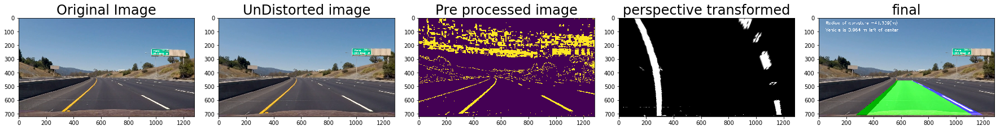

  3%|▎         | 42/1261 [01:04<31:27,  1.55s/it]

First  (288.0, 1148.0)
1 (283.0, 1119.0)
2 (250.0, 1076.0)
3 (198.0, 1016.0)
[[  288.  1148.]
 [  283.  1119.]
 [  250.  1076.]
 [  198.  1016.]]


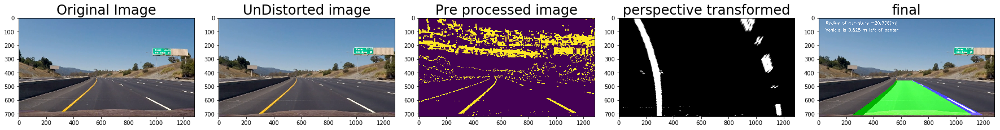

  3%|▎         | 43/1261 [01:05<31:24,  1.55s/it]

First  (286.0, 1157.0)
1 (282.0, 1113.0)
2 (246.0, 1089.0)
3 (194.0, 1004.0)
[[  286.  1157.]
 [  282.  1113.]
 [  246.  1089.]
 [  194.  1004.]]


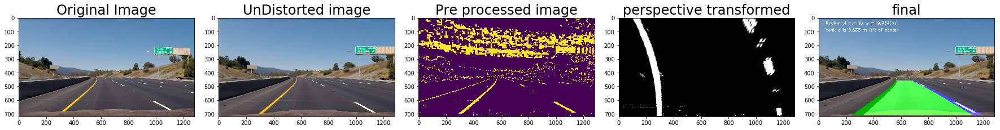

  3%|▎         | 44/1261 [01:07<31:51,  1.57s/it]

First  (287.0, 1158.0)
1 (282.0, 1113.0)
2 (244.0, 1098.0)
3 (191.0, 998.0)
[[  287.  1158.]
 [  282.  1113.]
 [  244.  1098.]
 [  191.   998.]]


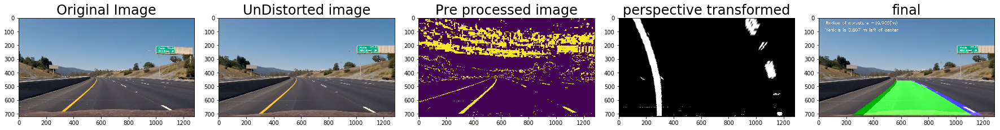

  4%|▎         | 45/1261 [01:08<31:09,  1.54s/it]

First  (289.0, 1163.0)
1 (279.0, 1112.0)
2 (241.0, 1092.0)
3 (190.0, 992.0)
[[  289.  1163.]
 [  279.  1112.]
 [  241.  1092.]
 [  190.   992.]]


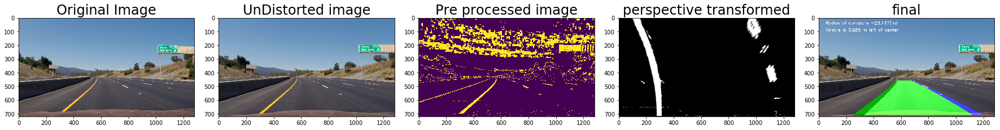

  4%|▎         | 46/1261 [01:10<30:52,  1.52s/it]

First  (287.0, 1158.0)
1 (278.0, 1117.0)
2 (239.0, 1090.0)
3 (189.0, 998.0)
[[  287.  1158.]
 [  278.  1117.]
 [  239.  1090.]
 [  189.   998.]]


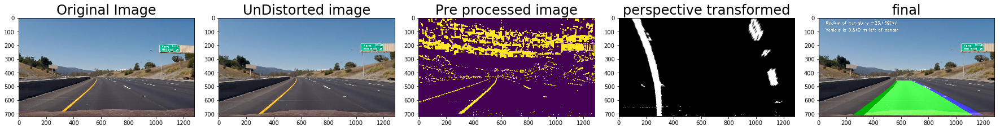

  4%|▎         | 47/1261 [01:11<31:29,  1.56s/it]

First  (290.0, 1150.0)
1 (274.0, 1122.0)
2 (237.0, 1074.0)
3 (188.0, 999.0)
[[  290.  1150.]
 [  274.  1122.]
 [  237.  1074.]
 [  188.   999.]]


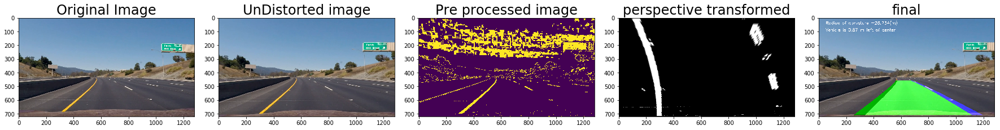

  4%|▍         | 48/1261 [01:13<31:01,  1.53s/it]

First  (296.0, 1156.0)
1 (272.0, 1131.0)
2 (233.0, 1084.0)
3 (1016.0, 1016.0)
[[  296.  1156.]
 [  272.  1131.]
 [  233.  1084.]
 [  233.  1016.]]


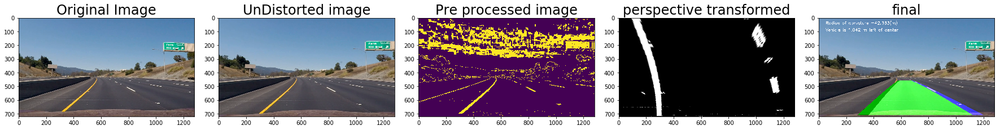

  4%|▍         | 49/1261 [01:15<31:00,  1.53s/it]

First  (297.0, 1155.0)
1 (268.0, 1135.0)
2 (232.0, 1092.0)
3 (1025.0, 1025.0)
[[  297.  1155.]
 [  268.  1135.]
 [  232.  1092.]
 [  232.  1025.]]


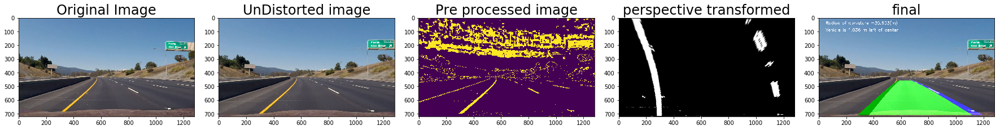

  4%|▍         | 50/1261 [01:16<31:08,  1.54s/it]

First  (297.0, 1141.0)
1 (266.0, 1136.0)
2 (229.0, 1062.0)
3 (175.0, 1035.0)
[[  297.  1141.]
 [  266.  1136.]
 [  229.  1062.]
 [  175.  1035.]]


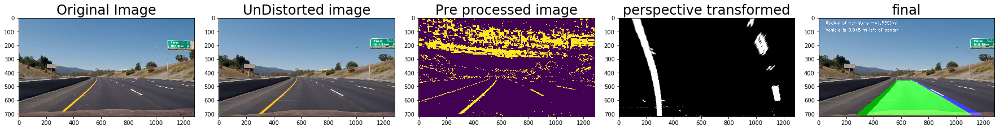

  4%|▍         | 51/1261 [01:18<30:53,  1.53s/it]

First  (300.0, 1148.0)
1 (267.0, 1123.0)
2 (231.0, 1050.0)
3 (177.0, 1035.0)
[[  300.  1148.]
 [  267.  1123.]
 [  231.  1050.]
 [  177.  1035.]]


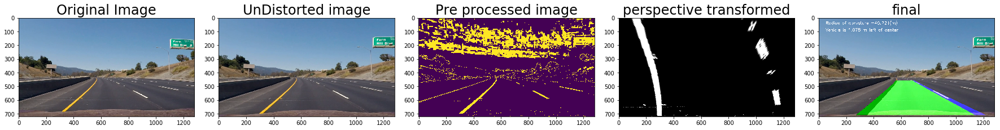

  4%|▍         | 52/1261 [01:19<31:02,  1.54s/it]

First  (299.0, 1142.0)
1 (266.0, 1121.0)
2 (230.0, 1049.0)
3 (177.0, 1016.0)
[[  299.  1142.]
 [  266.  1121.]
 [  230.  1049.]
 [  177.  1016.]]


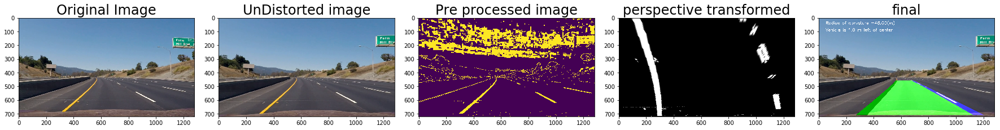

  4%|▍         | 53/1261 [01:21<30:43,  1.53s/it]

First  (298.0, 1144.0)
1 (265.0, 1109.0)
2 (230.0, 1054.0)
3 (179.0, 1003.0)
[[  298.  1144.]
 [  265.  1109.]
 [  230.  1054.]
 [  179.  1003.]]


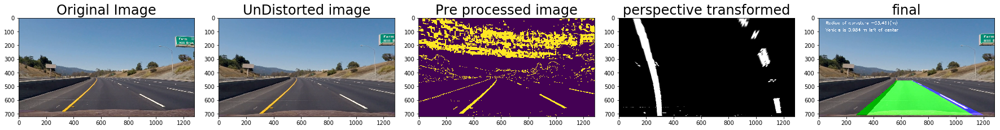

  4%|▍         | 54/1261 [01:22<30:27,  1.51s/it]

First  (281.0, 1144.0)
1 (262.0, 1117.0)
2 (226.0, 1064.0)
3 (179.0, 1002.0)
[[  281.  1144.]
 [  262.  1117.]
 [  226.  1064.]
 [  179.  1002.]]


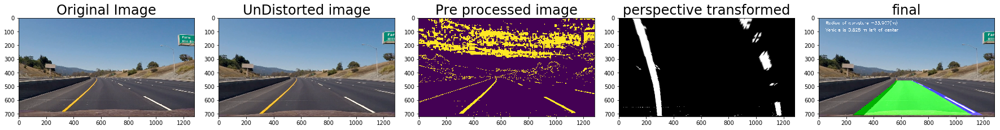

  4%|▍         | 55/1261 [01:24<30:38,  1.52s/it]

First  (287.0, 1145.0)
1 (261.0, 1124.0)
2 (224.0, 1076.0)
3 (178.0, 1016.0)
[[  287.  1145.]
 [  261.  1124.]
 [  224.  1076.]
 [  178.  1016.]]


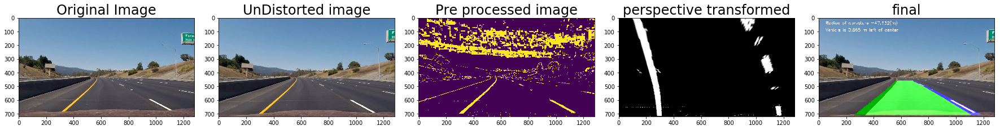

  4%|▍         | 56/1261 [01:25<30:29,  1.52s/it]

First  (286.0, 1144.0)
1 (262.0, 1104.0)
2 (222.0, 1082.0)
3 (181.0, 991.0)
[[  286.  1144.]
 [  262.  1104.]
 [  222.  1082.]
 [  181.   991.]]


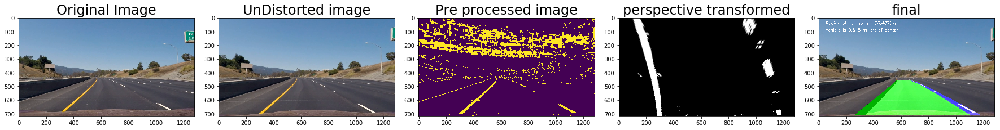

  5%|▍         | 57/1261 [01:27<30:14,  1.51s/it]

First  (285.0, 1144.0)
1 (260.0, 1099.0)
2 (221.0, 1089.0)
3 (183.0, 989.0)
[[  285.  1144.]
 [  260.  1099.]
 [  221.  1089.]
 [  183.   989.]]


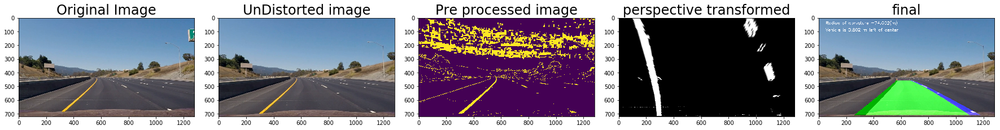

  5%|▍         | 58/1261 [01:28<30:29,  1.52s/it]

First  (288.0, 1137.0)
1 (262.0, 1094.0)
2 (224.0, 1067.0)
3 (191.0, 967.0)
[[  288.  1137.]
 [  262.  1094.]
 [  224.  1067.]
 [  191.   967.]]


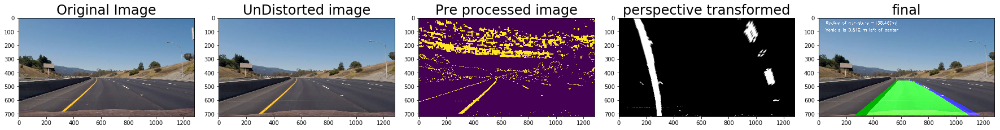

  5%|▍         | 59/1261 [01:30<30:15,  1.51s/it]

First  (286.0, 1148.0)
1 (264.0, 1096.0)
2 (229.0, 1038.0)
3 (193.0, 967.0)
[[  286.  1148.]
 [  264.  1096.]
 [  229.  1038.]
 [  193.   967.]]


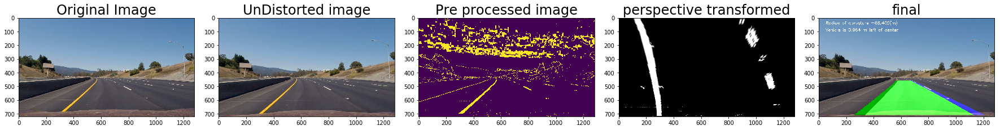

  5%|▍         | 60/1261 [01:31<30:06,  1.50s/it]

First  (289.0, 1131.0)
1 (265.0, 1102.0)
2 (233.0, 1045.0)
3 (194.0, 976.0)
[[  289.  1131.]
 [  265.  1102.]
 [  233.  1045.]
 [  194.   976.]]


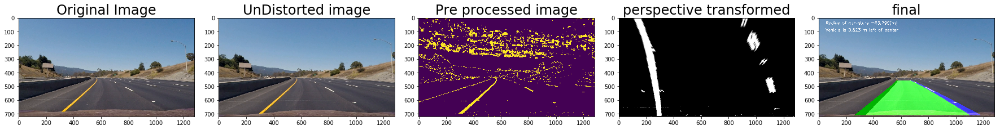

  5%|▍         | 61/1261 [01:33<30:31,  1.53s/it]

First  (291.0, 1129.0)
1 (262.0, 1106.0)
2 (236.0, 1012.0)
3 (193.0, 983.0)
[[  291.  1129.]
 [  262.  1106.]
 [  236.  1012.]
 [  193.   983.]]


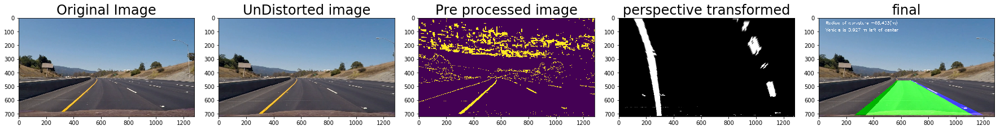

  5%|▍         | 62/1261 [01:34<30:12,  1.51s/it]

First  (288.0, 1114.0)
1 (258.0, 1108.0)
2 (236.0, 1008.0)
3 (193.0, 994.0)
[[  288.  1114.]
 [  258.  1108.]
 [  236.  1008.]
 [  193.   994.]]


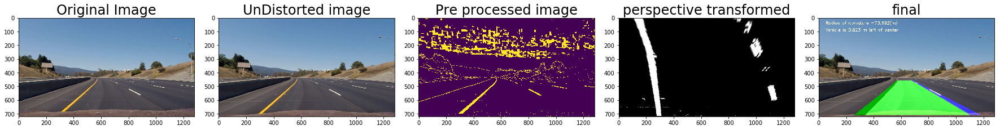

  5%|▍         | 63/1261 [01:36<30:27,  1.53s/it]

First  (289.0, 1119.0)
1 (260.0, 1098.0)
2 (238.0, 1011.0)
3 (196.0, 982.0)
[[  289.  1119.]
 [  260.  1098.]
 [  238.  1011.]
 [  196.   982.]]


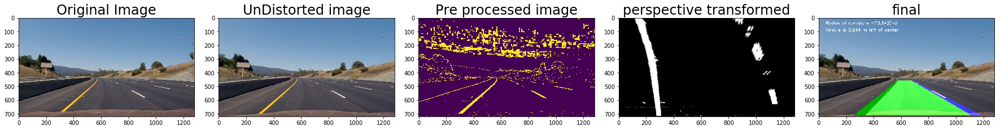

  5%|▌         | 64/1261 [01:37<30:05,  1.51s/it]

First  (286.0, 1123.0)
1 (258.0, 1099.0)
2 (238.0, 1021.0)
3 (192.0, 989.0)
[[  286.  1123.]
 [  258.  1099.]
 [  238.  1021.]
 [  192.   989.]]


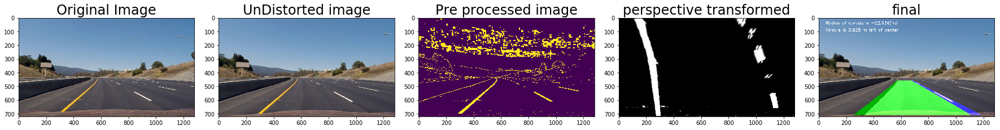

  5%|▌         | 65/1261 [01:39<29:53,  1.50s/it]

First  (287.0, 1125.0)
1 (255.0, 1085.0)
2 (240.0, 1029.0)
3 (195.0, 981.0)
[[  287.  1125.]
 [  255.  1085.]
 [  240.  1029.]
 [  195.   981.]]


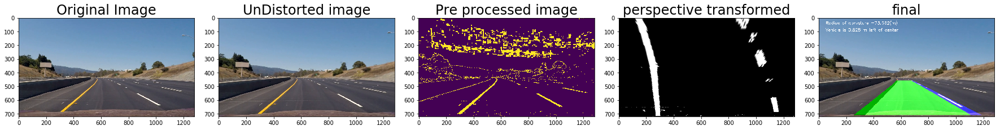

  5%|▌         | 66/1261 [01:40<30:13,  1.52s/it]

First  (286.0, 1129.0)
1 (254.0, 1091.0)
2 (240.0, 1039.0)
3 (193.0, 987.0)
[[  286.  1129.]
 [  254.  1091.]
 [  240.  1039.]
 [  193.   987.]]


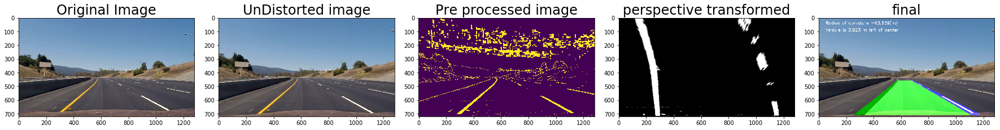

  5%|▌         | 67/1261 [01:42<30:02,  1.51s/it]

First  (282.0, 1127.0)
1 (265.0, 1095.0)
2 (235.0, 1051.0)
3 (191.0, 964.0)
[[  282.  1127.]
 [  265.  1095.]
 [  235.  1051.]
 [  191.   964.]]


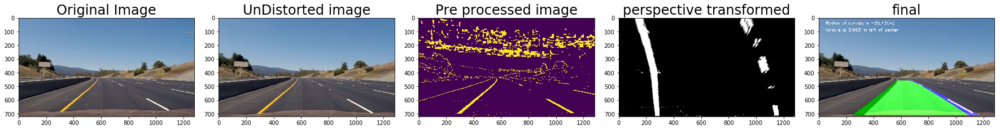

  5%|▌         | 68/1261 [01:43<30:09,  1.52s/it]

First  (284.0, 1124.0)
1 (267.0, 1074.0)
2 (237.0, 1054.0)
3 (195.0, 954.0)
[[  284.  1124.]
 [  267.  1074.]
 [  237.  1054.]
 [  195.   954.]]


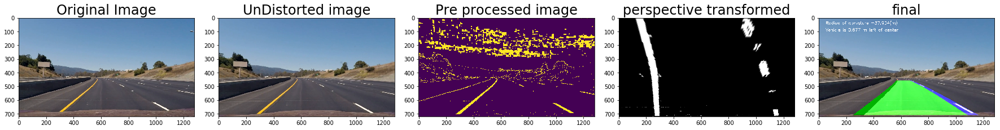

  5%|▌         | 69/1261 [01:45<30:53,  1.55s/it]

First  (282.0, 1127.0)
1 (265.0, 1077.0)
2 (232.0, 1054.0)
3 (191.0, 954.0)
[[  282.  1127.]
 [  265.  1077.]
 [  232.  1054.]
 [  191.   954.]]


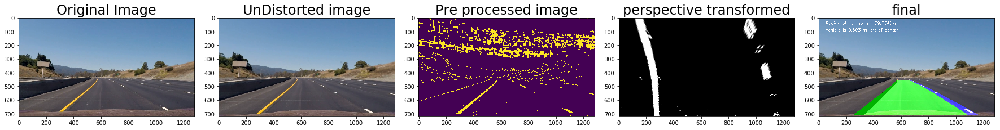

  6%|▌         | 70/1261 [01:46<30:44,  1.55s/it]

First  (281.0, 1114.0)
1 (268.0, 1074.0)
2 (230.0, 1050.0)
3 (194.0, 959.0)
[[  281.  1114.]
 [  268.  1074.]
 [  230.  1050.]
 [  194.   959.]]


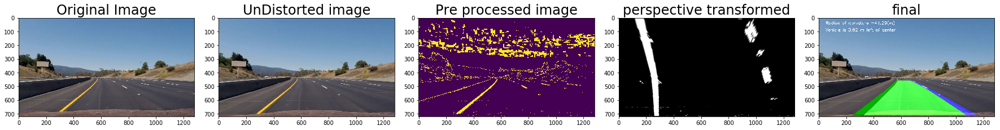

  6%|▌         | 71/1261 [01:48<30:41,  1.55s/it]

First  (281.0, 1144.0)
1 (262.0, 1081.0)
2 (227.0, 1052.0)
3 (190.0, 972.0)
[[  281.  1144.]
 [  262.  1081.]
 [  227.  1052.]
 [  190.   972.]]


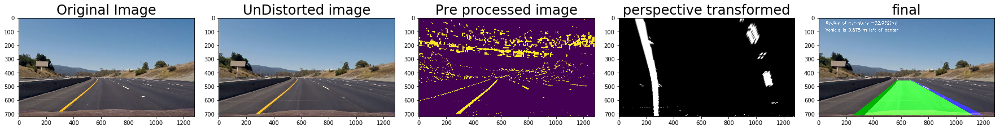

  6%|▌         | 72/1261 [01:50<31:05,  1.57s/it]

First  (280.0, 1128.0)
1 (262.0, 1090.0)
2 (224.0, 1045.0)
3 (188.0, 982.0)
[[  280.  1128.]
 [  262.  1090.]
 [  224.  1045.]
 [  188.   982.]]


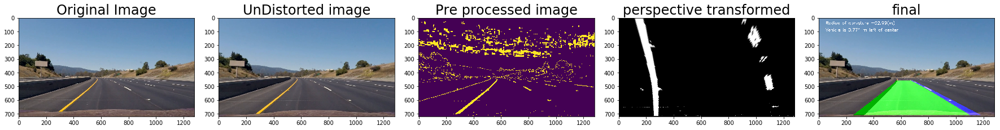

  6%|▌         | 73/1261 [01:51<30:53,  1.56s/it]

First  (281.0, 1117.0)
1 (259.0, 1094.0)
2 (222.0, 1056.0)
3 (186.0, 992.0)
[[  281.  1117.]
 [  259.  1094.]
 [  222.  1056.]
 [  186.   992.]]


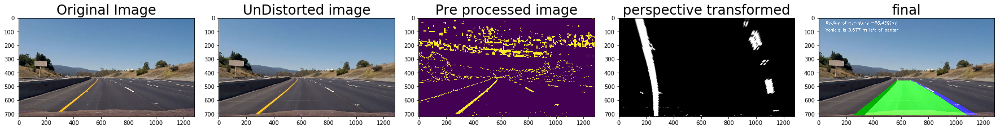

  6%|▌         | 74/1261 [01:53<31:19,  1.58s/it]

First  (278.0, 1119.0)
1 (250.0, 1099.0)
2 (219.0, 1056.0)
3 (181.0, 1007.0)
[[  278.  1119.]
 [  250.  1099.]
 [  219.  1056.]
 [  181.  1007.]]


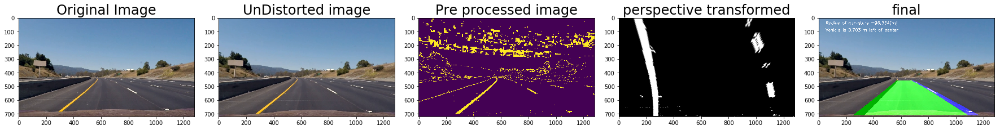

  6%|▌         | 75/1261 [01:54<31:06,  1.57s/it]

First  (276.0, 1106.0)
1 (248.0, 1097.0)
2 (220.0, 1034.0)
3 (183.0, 1012.0)
[[  276.  1106.]
 [  248.  1097.]
 [  220.  1034.]
 [  183.  1012.]]


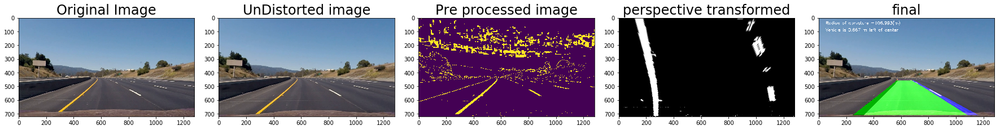

  6%|▌         | 76/1261 [01:56<30:50,  1.56s/it]

First  (272.0, 1114.0)
1 (240.0, 1098.0)
2 (212.0, 1044.0)
3 (175.0, 1029.0)
[[  272.  1114.]
 [  240.  1098.]
 [  212.  1044.]
 [  175.  1029.]]


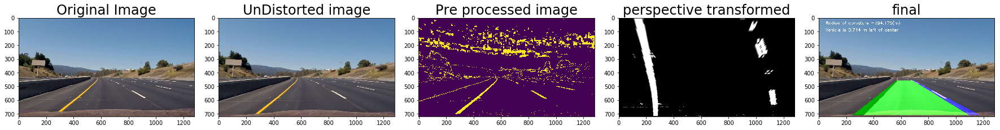

  6%|▌         | 77/1261 [01:58<31:19,  1.59s/it]

First  (270.0, 1130.0)
1 (238.0, 1103.0)
2 (210.0, 1048.0)
3 (175.0, 1030.0)
[[  270.  1130.]
 [  238.  1103.]
 [  210.  1048.]
 [  175.  1030.]]


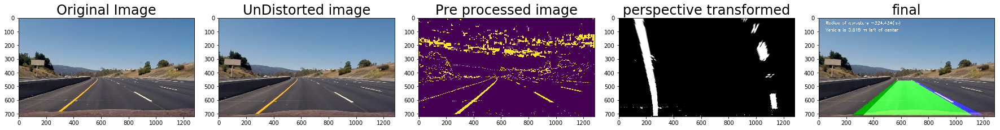

  6%|▌         | 78/1261 [01:59<30:43,  1.56s/it]

First  (266.0, 1119.0)
1 (233.0, 1101.0)
2 (208.0, 1053.0)
3 (172.0, 1033.0)
[[  266.  1119.]
 [  233.  1101.]
 [  208.  1053.]
 [  172.  1033.]]


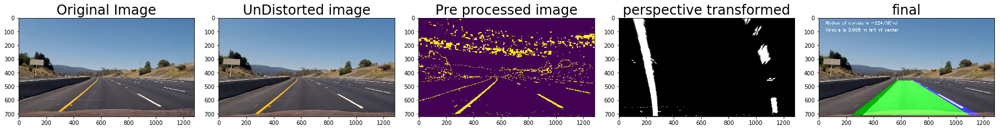

  6%|▋         | 79/1261 [02:01<30:12,  1.53s/it]

First  (262.0, 1118.0)
1 (233.0, 1103.0)
2 (206.0, 1061.0)
3 (172.0, 1019.0)
[[  262.  1118.]
 [  233.  1103.]
 [  206.  1061.]
 [  172.  1019.]]


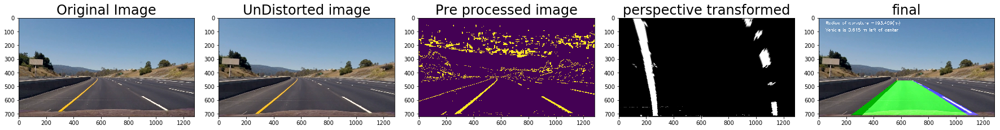

  6%|▋         | 80/1261 [02:02<30:14,  1.54s/it]

First  (243.0, 1142.0)
1 (231.0, 1105.0)
2 (207.0, 1065.0)
3 (178.0, 1010.0)
[[  243.  1142.]
 [  231.  1105.]
 [  207.  1065.]
 [  178.  1010.]]


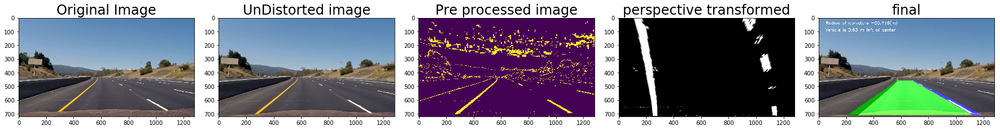

  6%|▋         | 81/1261 [02:04<29:45,  1.51s/it]

First  (240.0, 1112.0)
1 (231.0, 1095.0)
2 (206.0, 1074.0)
3 (176.0, 991.0)
[[  240.  1112.]
 [  231.  1095.]
 [  206.  1074.]
 [  176.   991.]]


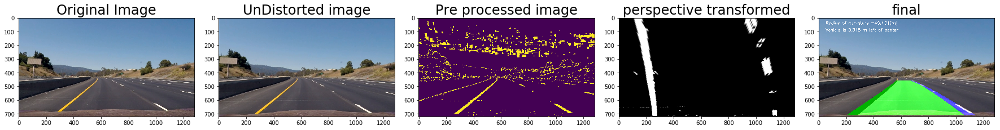

  7%|▋         | 82/1261 [02:05<29:33,  1.50s/it]

First  (238.0, 1114.0)
1 (233.0, 1089.0)
2 (204.0, 1077.0)
3 (178.0, 983.0)
[[  238.  1114.]
 [  233.  1089.]
 [  204.  1077.]
 [  178.   983.]]


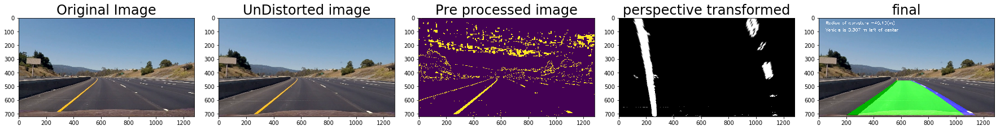

  7%|▋         | 83/1261 [02:07<29:41,  1.51s/it]

First  (245.0, 1128.0)
1 (228.0, 1099.0)
2 (199.0, 1087.0)
3 (171.0, 1003.0)
[[  245.  1128.]
 [  228.  1099.]
 [  199.  1087.]
 [  171.  1003.]]


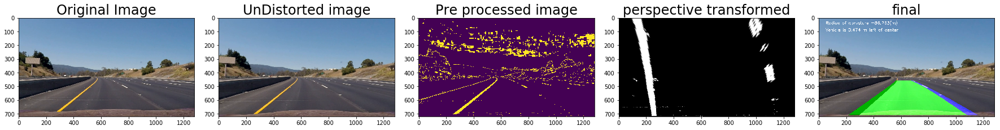

  7%|▋         | 84/1261 [02:08<29:23,  1.50s/it]

First  (233.0, 1126.0)
1 (229.0, 1100.0)
2 (200.0, 1083.0)
3 (175.0, 1004.0)
[[  233.  1126.]
 [  229.  1100.]
 [  200.  1083.]
 [  175.  1004.]]


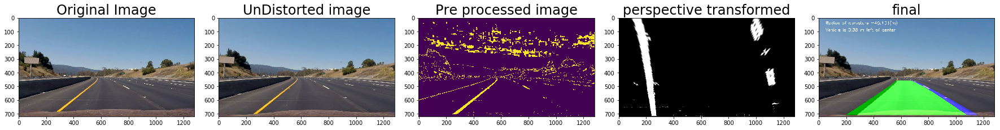

  7%|▋         | 85/1261 [02:10<29:39,  1.51s/it]

First  (240.0, 1125.0)
1 (229.0, 1106.0)
2 (202.0, 1072.0)
3 (179.0, 1009.0)
[[  240.  1125.]
 [  229.  1106.]
 [  202.  1072.]
 [  179.  1009.]]


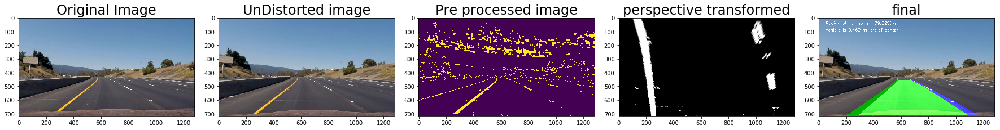

  7%|▋         | 86/1261 [02:11<29:19,  1.50s/it]

First  (255.0, 1124.0)
1 (239.0, 1105.0)
2 (212.0, 1067.0)
3 (186.0, 1011.0)
[[  255.  1124.]
 [  239.  1105.]
 [  212.  1067.]
 [  186.  1011.]]


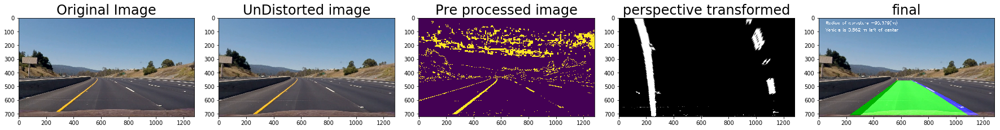

  7%|▋         | 87/1261 [02:12<29:05,  1.49s/it]

First  (260.0, 1103.0)
1 (232.0, 1101.0)
2 (222.0, 1033.0)
3 (192.0, 1015.0)
[[  260.  1103.]
 [  232.  1101.]
 [  222.  1033.]
 [  192.  1015.]]


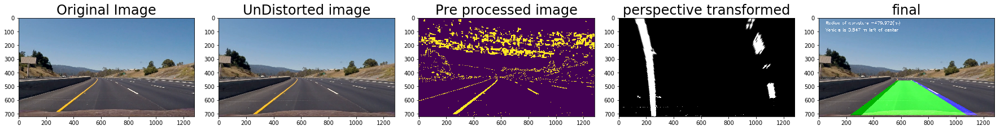

  7%|▋         | 88/1261 [02:14<29:24,  1.50s/it]

First  (263.0, 1112.0)
1 (248.0, 1094.0)
2 (226.0, 1030.0)
3 (197.0, 1013.0)
[[  263.  1112.]
 [  248.  1094.]
 [  226.  1030.]
 [  197.  1013.]]


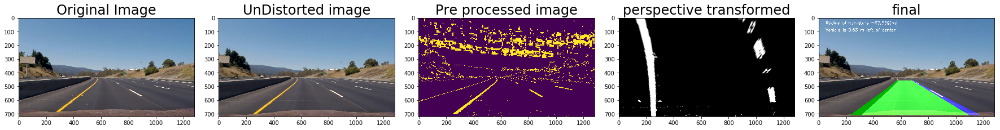

  7%|▋         | 89/1261 [02:15<29:07,  1.49s/it]

First  (268.0, 1119.0)
1 (258.0, 1088.0)
2 (236.0, 1021.0)
3 (204.0, 994.0)
[[  268.  1119.]
 [  258.  1088.]
 [  236.  1021.]
 [  204.   994.]]


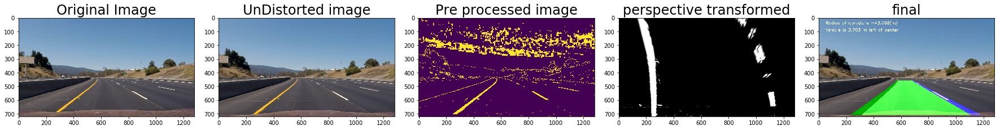

  7%|▋         | 90/1261 [02:17<28:55,  1.48s/it]

First  (267.0, 1110.0)
1 (256.0, 1082.0)
2 (235.0, 1035.0)
3 (203.0, 996.0)
[[  267.  1110.]
 [  256.  1082.]
 [  235.  1035.]
 [  203.   996.]]


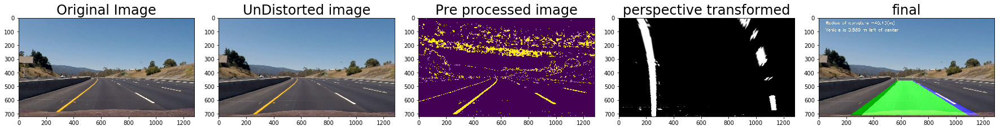

  7%|▋         | 91/1261 [02:19<29:37,  1.52s/it]

First  (268.0, 1114.0)
1 (258.0, 1089.0)
2 (232.0, 1045.0)
3 (202.0, 985.0)
[[  268.  1114.]
 [  258.  1089.]
 [  232.  1045.]
 [  202.   985.]]


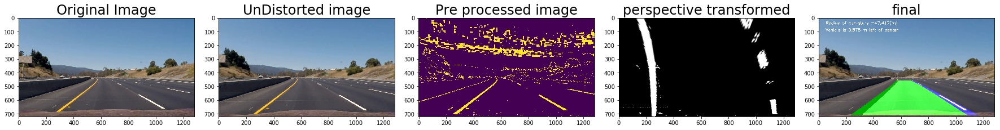

  7%|▋         | 92/1261 [02:20<29:06,  1.49s/it]

First  (269.0, 1113.0)
1 (261.0, 1088.0)
2 (237.0, 1051.0)
3 (205.0, 974.0)
[[  269.  1113.]
 [  261.  1088.]
 [  237.  1051.]
 [  205.   974.]]


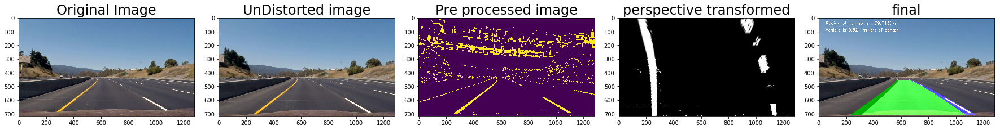

  7%|▋         | 93/1261 [02:21<28:50,  1.48s/it]

First  (273.0, 1113.0)
1 (266.0, 1076.0)
2 (238.0, 1057.0)
3 (208.0, 969.0)
[[  273.  1113.]
 [  266.  1076.]
 [  238.  1057.]
 [  208.   969.]]


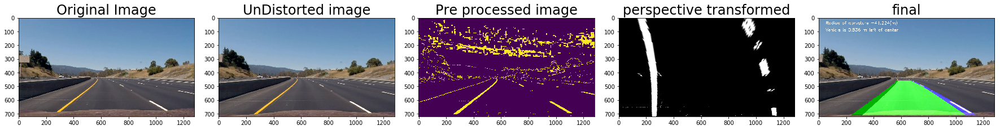

  7%|▋         | 94/1261 [02:23<29:01,  1.49s/it]

First  (273.0, 1113.0)
1 (263.0, 1073.0)
2 (235.0, 1057.0)
3 (205.0, 965.0)
[[  273.  1113.]
 [  263.  1073.]
 [  235.  1057.]
 [  205.   965.]]


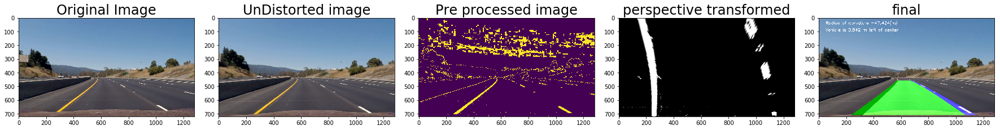

  8%|▊         | 95/1261 [02:24<29:04,  1.50s/it]

First  (273.0, 1102.0)
1 (264.0, 1075.0)
2 (235.0, 1053.0)
3 (207.0, 970.0)
[[  273.  1102.]
 [  264.  1075.]
 [  235.  1053.]
 [  207.   970.]]


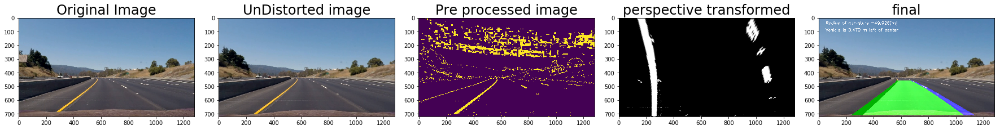

  8%|▊         | 96/1261 [02:26<29:26,  1.52s/it]

First  (275.0, 1114.0)
1 (265.0, 1080.0)
2 (235.0, 1054.0)
3 (205.0, 979.0)
[[  275.  1114.]
 [  265.  1080.]
 [  235.  1054.]
 [  205.   979.]]


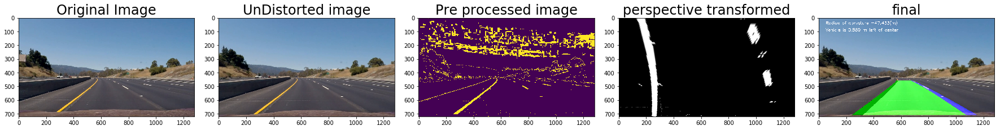

  8%|▊         | 97/1261 [02:28<29:18,  1.51s/it]

First  (273.0, 1111.0)
1 (261.0, 1090.0)
2 (232.0, 1052.0)
3 (204.0, 993.0)
[[  273.  1111.]
 [  261.  1090.]
 [  232.  1052.]
 [  204.   993.]]


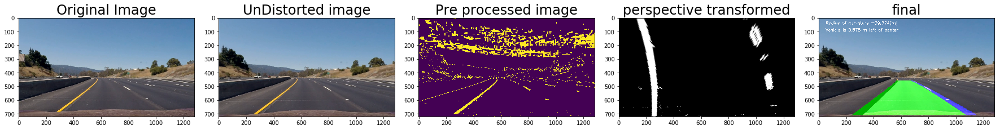

  8%|▊         | 98/1261 [02:29<29:32,  1.52s/it]

First  (277.0, 1112.0)
1 (264.0, 1093.0)
2 (234.0, 1053.0)
3 (202.0, 1000.0)
[[  277.  1112.]
 [  264.  1093.]
 [  234.  1053.]
 [  202.  1000.]]


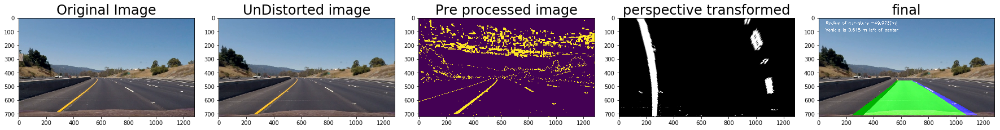

  8%|▊         | 99/1261 [02:31<30:12,  1.56s/it]

First  (277.0, 1115.0)
1 (247.0, 1099.0)
2 (234.0, 1047.0)
3 (201.0, 1013.0)
[[  277.  1115.]
 [  247.  1099.]
 [  234.  1047.]
 [  201.  1013.]]


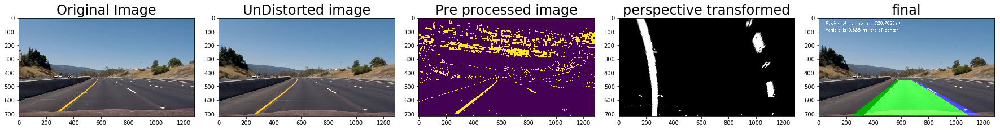

  8%|▊         | 100/1261 [02:32<29:59,  1.55s/it]

First  (279.0, 1106.0)
1 (250.0, 1098.0)
2 (237.0, 1042.0)
3 (203.0, 1020.0)
[[  279.  1106.]
 [  250.  1098.]
 [  237.  1042.]
 [  203.  1020.]]


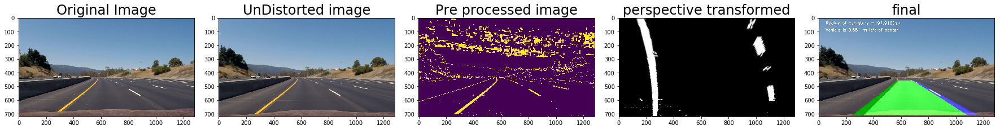

  8%|▊         | 101/1261 [02:34<29:45,  1.54s/it]

First  (281.0, 1103.0)
1 (250.0, 1089.0)
2 (237.0, 1035.0)
3 (203.0, 1013.0)
[[  281.  1103.]
 [  250.  1089.]
 [  237.  1035.]
 [  203.  1013.]]


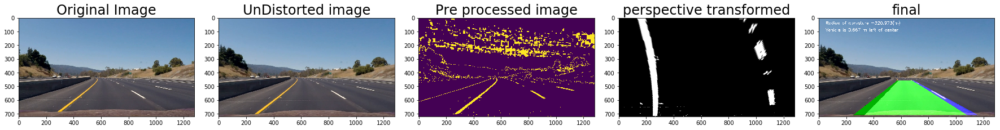

  8%|▊         | 102/1261 [02:35<29:51,  1.55s/it]

First  (281.0, 1114.0)
1 (250.0, 1094.0)
2 (237.0, 1039.0)
3 (204.0, 1014.0)
[[  281.  1114.]
 [  250.  1094.]
 [  237.  1039.]
 [  204.  1014.]]


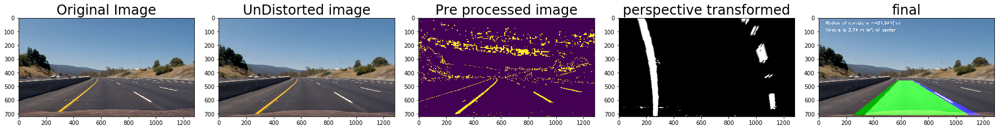

  8%|▊         | 103/1261 [02:37<29:29,  1.53s/it]

First  (282.0, 1117.0)
1 (250.0, 1091.0)
2 (241.0, 1048.0)
3 (207.0, 1010.0)
[[  282.  1117.]
 [  250.  1091.]
 [  241.  1048.]
 [  207.  1010.]]


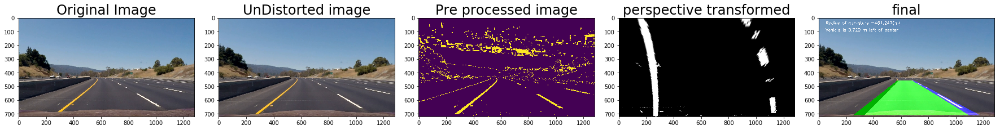

  8%|▊         | 104/1261 [02:38<29:08,  1.51s/it]

First  (279.0, 1117.0)
1 (257.0, 1103.0)
2 (238.0, 1063.0)
3 (203.0, 1019.0)
[[  279.  1117.]
 [  257.  1103.]
 [  238.  1063.]
 [  203.  1019.]]


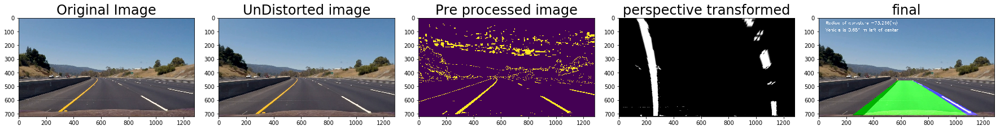

  8%|▊         | 105/1261 [02:40<29:16,  1.52s/it]

First  (276.0, 1118.0)
1 (256.0, 1108.0)
2 (237.0, 1074.0)
3 (203.0, 1029.0)
[[  276.  1118.]
 [  256.  1108.]
 [  237.  1074.]
 [  203.  1029.]]


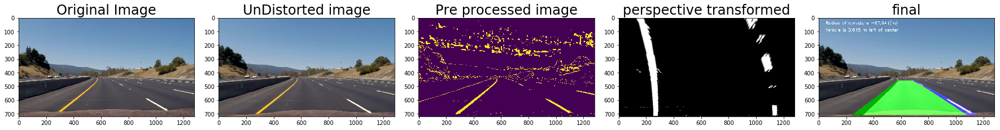

  8%|▊         | 106/1261 [02:41<29:20,  1.52s/it]

First  (276.0, 1130.0)
1 (262.0, 1109.0)
2 (234.0, 1088.0)
3 (202.0, 1049.0)
[[  276.  1130.]
 [  262.  1109.]
 [  234.  1088.]
 [  202.  1049.]]


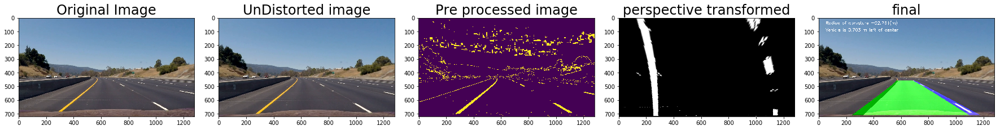

  8%|▊         | 107/1261 [02:43<29:44,  1.55s/it]

First  (270.0, 1119.0)
1 (267.0, 1104.0)
2 (238.0, 1088.0)
3 (207.0, 1015.0)
[[  270.  1119.]
 [  267.  1104.]
 [  238.  1088.]
 [  207.  1015.]]


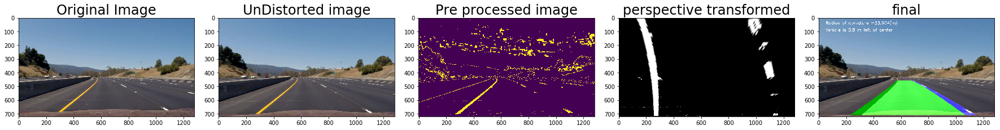

  9%|▊         | 108/1261 [02:44<29:33,  1.54s/it]

First  (278.0, 1124.0)
1 (269.0, 1099.0)
2 (240.0, 1084.0)
3 (210.0, 1005.0)
[[  278.  1124.]
 [  269.  1099.]
 [  240.  1084.]
 [  210.  1005.]]


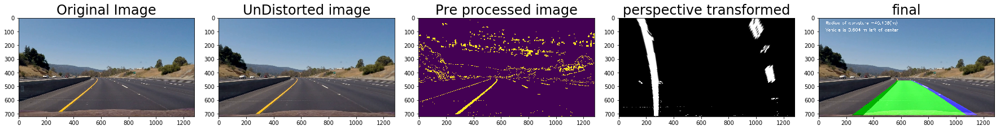

  9%|▊         | 109/1261 [02:46<29:25,  1.53s/it]

First  (280.0, 1127.0)
1 (269.0, 1105.0)
2 (241.0, 1082.0)
3 (211.0, 1011.0)
[[  280.  1127.]
 [  269.  1105.]
 [  241.  1082.]
 [  211.  1011.]]


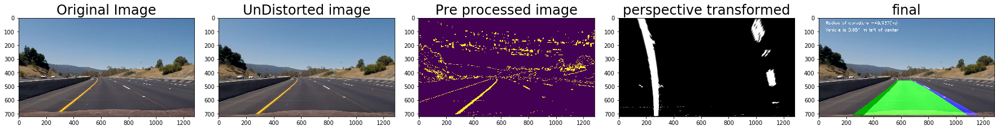

  9%|▊         | 110/1261 [02:48<29:38,  1.54s/it]

First  (282.0, 1128.0)
1 (270.0, 1111.0)
2 (242.0, 1074.0)
3 (214.0, 1018.0)
[[  282.  1128.]
 [  270.  1111.]
 [  242.  1074.]
 [  214.  1018.]]


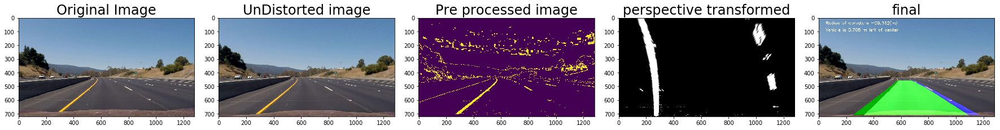

  9%|▉         | 111/1261 [02:49<29:35,  1.54s/it]

First  (283.0, 1134.0)
1 (268.0, 1121.0)
2 (238.0, 1096.0)
3 (206.0, 1038.0)
[[  283.  1134.]
 [  268.  1121.]
 [  238.  1096.]
 [  206.  1038.]]


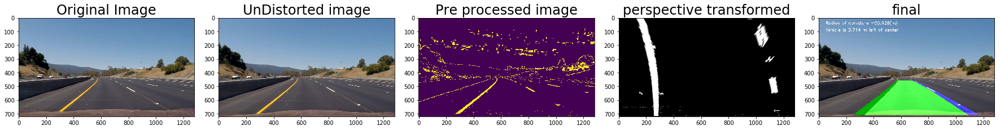

  9%|▉         | 112/1261 [02:51<29:29,  1.54s/it]

First  (286.0, 1133.0)
1 (259.0, 1118.0)
2 (242.0, 1084.0)
3 (209.0, 1037.0)
[[  286.  1133.]
 [  259.  1118.]
 [  242.  1084.]
 [  209.  1037.]]


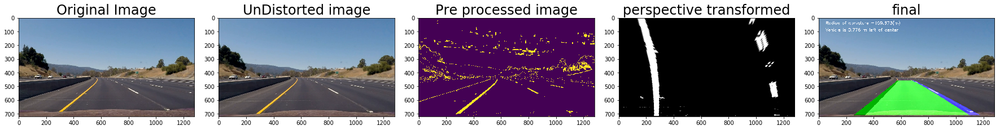

  9%|▉         | 113/1261 [02:52<29:28,  1.54s/it]

First  (288.0, 1130.0)
1 (260.0, 1117.0)
2 (246.0, 1067.0)
3 (209.0, 1048.0)
[[  288.  1130.]
 [  260.  1117.]
 [  246.  1067.]
 [  209.  1048.]]


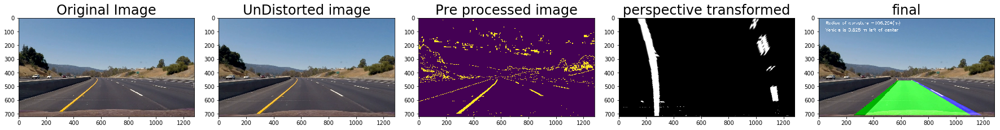

  9%|▉         | 114/1261 [02:54<29:07,  1.52s/it]

First  (291.0, 1128.0)
1 (263.0, 1111.0)
2 (252.0, 1059.0)
3 (215.0, 1045.0)
[[  291.  1128.]
 [  263.  1111.]
 [  252.  1059.]
 [  215.  1045.]]


In [ ]:
# Video processing
input_video = './project_video.mp4'
output_video = 'output1_tracked.mp4'

clip1 = VideoFileClip(input_video, audio = False)
video_clip = clip1.fl_image(process_img)
video_clip.write_videofile(output_video, audio = False)
print('Done')

In [8]:

# input_video = './challenge_video.mp4'
# output_video = 'challenge_video_tracked.mp4'

# clip1 = VideoFileClip(input_video, audio = False)
# video_clip = clip1.fl_image(process_img)
# video_clip.write_videofile(output_video, audio = False)
# print('Done')
